<a href="https://colab.research.google.com/github/leynessa/python_projects/blob/master/tree_census.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**NYC TREE CENSUS**







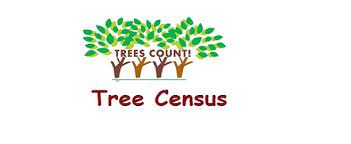

##Problem Statement

---

The goal of the project is to explore the data in the tree census dataset. The project will id the most common tree species and use geopandas to plot theur geolocation on a map od NYC



Dataset

---

This data set is from the NYC OpenData. IT contains data about trees on the street collected in 2015 Street Tree Census, which was conducted by volunteers and staff organized by NYC Parks & Recreation and partner organizations. Tree data collected includes tree species, diameter and perception of health. Accompanying blockface data is available indicating status of data collection and data release citywide. The dataset can be found at: https://data.cityofnewyork.us/Environment/2015-Street-Tree-Census-Tree-Data/uvpi-gqnh

Questions

---

How many different species of trees are there on the streets in NYC in 2016
How many healthy trees?
how many stumps or dead trees?
Where are the trees located ?

Import the relevant libraries and the files

---



In [1]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 4.1 MB/s 
     |████████████████████████████████| 7.8 MB 29.4 MB/s 
     |████████████████████████████████| 16.6 MB 49.4 MB/s 


In [14]:
import numpy as py
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point, Polygon

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df = pd.read_csv("2015_Street_Tree_Census_-_Tree_Data.csv")


Viewing snipets of data

---



In [15]:
df.head()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough,cncldist,st_assem,st_senate,nta,nta_name,boro_ct,state,latitude,longitude,x_sp,y_sp,council district,census tract,bin,bbl
0,180683,348711,08/27/2015,3,0,OnCurb,Alive,Fair,Acer rubrum,red maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,108-005 70 AVENUE,11375,Forest Hills,406,4,Queens,29,28,16,QN17,Forest Hills,4073900,New York,40.723092,-73.844215,1027431.148,202756.7687,29.0,739.0,4052307.0,4.022210e+09
1,200540,315986,09/03/2015,21,0,OnCurb,Alive,Fair,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,Stones,Yes,No,No,No,No,No,No,No,No,147-074 7 AVENUE,11357,Whitestone,407,4,Queens,19,27,11,QN49,Whitestone,4097300,New York,40.794111,-73.818679,1034455.701,228644.8374,19.0,973.0,4101931.0,4.044750e+09
2,204026,218365,09/05/2015,3,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,1or2,None,Damage,Volunteer,None,No,No,No,No,No,No,No,No,No,390 MORGAN AVENUE,11211,Brooklyn,301,3,Brooklyn,34,50,18,BK90,East Williamsburg,3044900,New York,40.717581,-73.936608,1001822.831,200716.8913,34.0,449.0,3338310.0,3.028870e+09
3,204337,217969,09/05/2015,10,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,1027 GRAND STREET,11211,Brooklyn,301,3,Brooklyn,34,53,18,BK90,East Williamsburg,3044900,New York,40.713537,-73.934456,1002420.358,199244.2531,34.0,449.0,3338342.0,3.029250e+09
4,189565,223043,08/30/2015,21,0,OnCurb,Alive,Good,Tilia americana,American linden,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,603 6 STREET,11215,Brooklyn,306,3,Brooklyn,39,44,21,BK37,Park Slope-Gowanus,3016500,New York,40.666778,-73.975979,990913.775,182202.4260,39.0,165.0,3025654.0,3.010850e+09


View the columns and choosing the relevant columns

In [16]:
df.columns

Index(['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough', 'cncldist',
       'st_assem', 'st_senate', 'nta', 'nta_name', 'boro_ct', 'state',
       'latitude', 'longitude', 'x_sp', 'y_sp', 'council district',
       'census tract', 'bin', 'bbl'],
      dtype='object')

In [17]:
tree_census_subset = df[['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough']]

Data **Dictionary**

---
Unique Tree ID Number- tree_id <br>
Date trees were mapped - created_at <br>
Diameter at breast height of tree -tree_dbh <br>
Diameter of stump -stump_diam <br>
Tree Status -status <br>
Tree Health- health <br>
more: file:///C:/Users/leyne/Downloads/StreetTreeCensus2015TreesDataDictionary20161102.pdf


In [18]:
tree_census_subset.columns

Index(['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough'],
      dtype='object')

In [19]:
tree_census_subset.tail()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
52376,251392,411286,09/23/2015,6,0,OnCurb,Alive,Good,Pyrus calleryana,Callery pear,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,855 IONIA AVENUE,10309,Staten Island,503,5,Staten Island
52377,253314,337395,09/24/2015,11,0,OnCurb,Alive,Good,Pyrus calleryana,Callery pear,None,None,NoDamage,NYC Parks Staff,None,No,No,No,No,No,No,No,No,No,113-036 SPRINGFIELD BOULEVARD,11429,Queens Village,413,4,Queens
52378,258987,204288,09/25/2015,3,0,OnCurb,Alive,Good,Morus,mulberry,None,None,NoDamage,Volunteer,WiresRope,No,No,No,Yes,No,No,No,No,No,565 76 STREET,11209,Brooklyn,310,3,Brooklyn
52379,239817,106170,09/19/2015,6,0,OffsetFromCurb,Alive,Fair,Pyrus calleryana,Callery pear,None,None,NoDamage,Volunteer,None,No,No,No,No,No,No,No,No,No,244 WEST 64 STREET,10023,New York,107,1,Manhattan
52380,251692,222643,09/23/2015,3,0,OnCurb,Alive,Good,Pyrus calleryana,Callery pear,None,None,NoDamage,Volunteer,None,No,No,No,No,No,No,No,No,No,1414 GREENE AVENUE,11237,Brooklyn,304,3,Brooklyn


Reviewing missing values

In [20]:
tree_census_subset.isna().sum()

tree_id               0
block_id              0
created_at            0
tree_dbh              0
stump_diam            0
curb_loc              0
status                0
health             2593
spc_latin          2592
spc_common         2592
steward            2592
guards             2592
sidewalk           2592
user_type             0
problems           2592
root_stone            0
root_grate            0
root_other            0
trunk_wire            0
trnk_light            0
trnk_other            0
brch_light            0
brch_shoe             0
brch_other            0
address               0
postcode              0
zip_city              0
community board       0
borocode              0
borough               0
dtype: int64

In [21]:
#show where health is a nul value
tree_census_subset[tree_census_subset['health'].isna()]

 #dataframe.notna() function detects existing/ non-missing values in the dataframe.

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
37,211205,302080,09/09/2015,0,16,OnCurb,Stump,NaN,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,21-023 24 DRIVE,11102,Astoria,401,4,Queens
57,187807,506266,08/29/2015,0,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,300 EAST MOSHOLU PARKWAY SOUTH,10458,Bronx,207,2,Bronx
196,208322,222858,09/07/2015,10,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,1691 DEKALB AVENUE,11237,Brooklyn,304,3,Brooklyn
209,209058,415850,09/08/2015,6,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,295 ROMA AVENUE,10306,Staten Island,503,5,Staten Island
239,203597,301947,09/04/2015,0,15,OnCurb,Stump,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,22-063 37 STREET,11105,Astoria,401,4,Queens
266,210544,216081,09/08/2015,6,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,111 DIAMOND STREET,11222,Brooklyn,301,3,Brooklyn
285,188609,107627,08/30/2015,9,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,413 EAST 79 STREET,10075,New York,108,1,Manhattan
430,189412,108374,08/30/2015,7,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,421 WEST 118 STREET,10027,New York,109,1,Manhattan
438,189526,223109,08/30/2015,4,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,242 7 AVENUE,11215,Brooklyn,306,3,Brooklyn
591,179748,348463,08/27/2015,20,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,113-014 72 ROAD,11375,Forest Hills,406,4,Queens


In [22]:
tree_census_subset.describe() #show the numerical values

,tree_id,block_id,tree_dbh,stump_diam,postcode,community board,borocode
count,52381.000000,52381.000000,52381.000000,52381.000000,52381.000000,52381.000000,52381.000000
mean,209873.787366,293371.936370,11.314790,0.464672,10883.969283,323.834253,3.165671
std,31140.756839,118413.527355,8.618383,3.346303,650.199103,122.709005,1.234791
min,9.000000,100078.000000,0.000000,0.000000,83.000000,101.000000,1.000000
25%,196183.000000,218069.000000,5.000000,0.000000,10312.000000,212.000000,2.000000
50%,212966.000000,306654.000000,10.000000,0.000000,11214.000000,315.000000,3.000000
75%,230874.000000,347942.000000,16.000000,0.000000,11365.000000,409.000000,4.000000
max,284470.000000,516315.000000,425.000000,140.000000,11697.000000,503.000000,5.000000


In [23]:
tree_census_subset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52381 entries, 0 to 52380
Data columns (total 30 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   tree_id          52381 non-null  int64 
 1   block_id         52381 non-null  int64 
 2   created_at       52381 non-null  object
 3   tree_dbh         52381 non-null  int64 
 4   stump_diam       52381 non-null  int64 
 5   curb_loc         52381 non-null  object
 6   status           52381 non-null  object
 7   health           49788 non-null  object
 8   spc_latin        49789 non-null  object
 9   spc_common       49789 non-null  object
 10  steward          49789 non-null  object
 11  guards           49789 non-null  object
 12  sidewalk         49789 non-null  object
 13  user_type        52381 non-null  object
 14  problems         49789 non-null  object
 15  root_stone       52381 non-null  object
 16  root_grate       52381 non-null  object
 17  root_other       52381 non-null

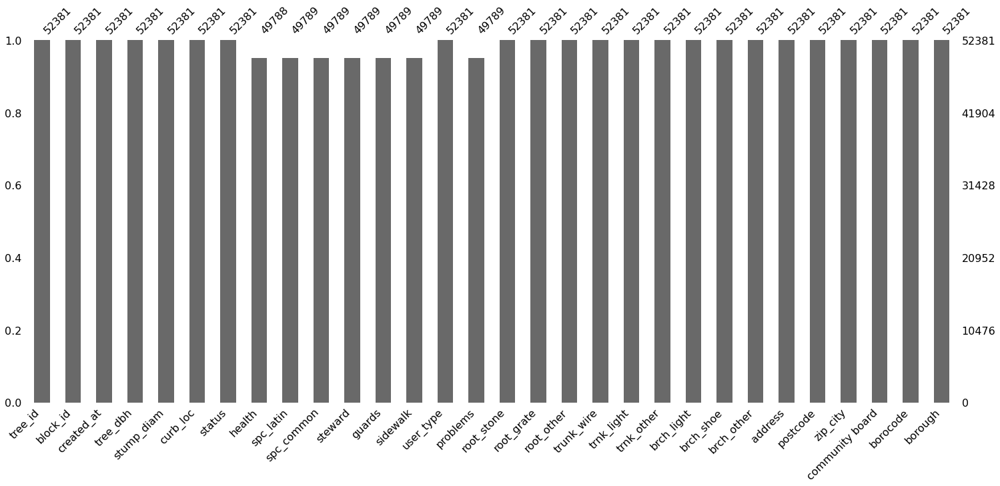

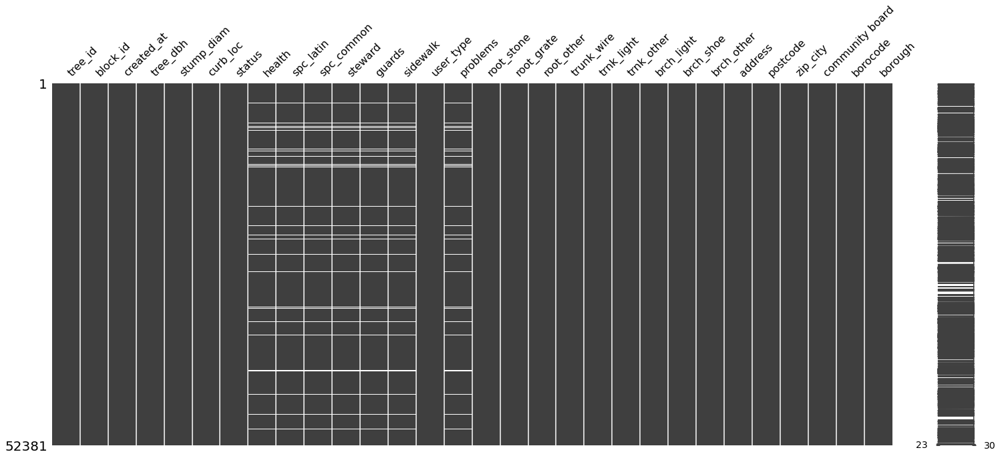

In [24]:
import missingno
missingno.bar(tree_census_subset)
missingno.matrix(tree_census_subset)



array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4f94d2d730>,
      dtype=object)

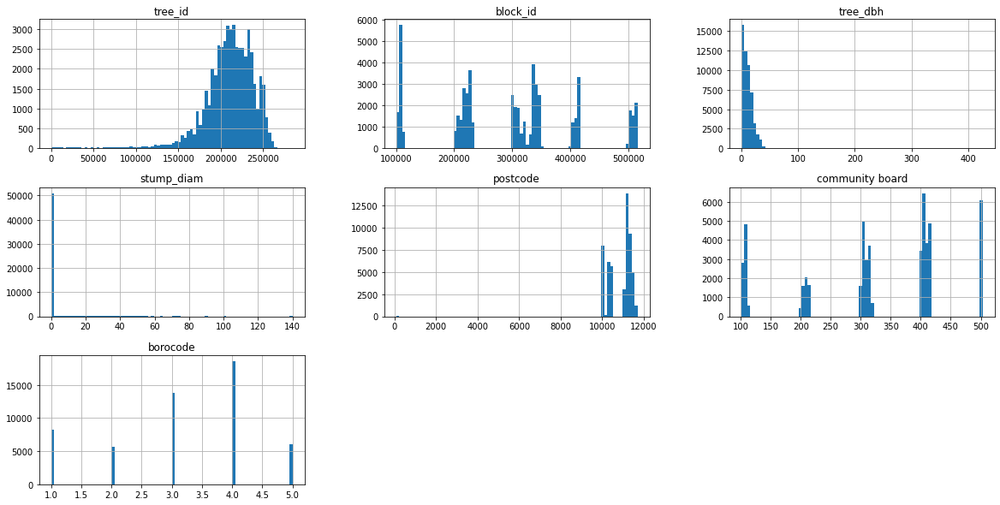

In [31]:
tree_census_subset.hist(bins=80, figsize= (20,10))

In [29]:
#query information about possivel outliers
big_tree = tree_census_subset[tree_census_subset['tree_dbh']>50]
big_tree.tail()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
47435,164944,323512,08/22/2015,57,0,OnCurb,Alive,Good,Populus grandidentata,bigtooth aspen,None,None,NoDamage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,35-026 CORPORAL KENNEDY STREET,11361,Bayside,411,4,Queens
48612,227604,335293,09/15/2015,60,0,OffsetFromCurb,Alive,Fair,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,221-039 BRADDOCK AVENUE,11427,Queens Village,413,4,Queens
48724,211850,415818,09/09/2015,61,0,OffsetFromCurb,Alive,Good,Acer saccharinum,silver maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,350 ISABELLA AVENUE,10306,Staten Island,503,5,Staten Island
49021,235508,412616,09/18/2015,89,0,OnCurb,Alive,Good,Liquidambar styraciflua,sweetgum,1or2,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,58 HEMLOCK STREET,10309,Staten Island,503,5,Staten Island
51002,223318,335764,09/14/2015,58,0,OffsetFromCurb,Alive,Fair,Quercus rubra,northern red oak,None,None,Damage,TreesCount Staff,Stones,Yes,No,No,No,No,No,No,No,No,80-059 232 STREET,11427,Queens Village,413,4,Queens


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f4f955ade80>,
      dtype=object)

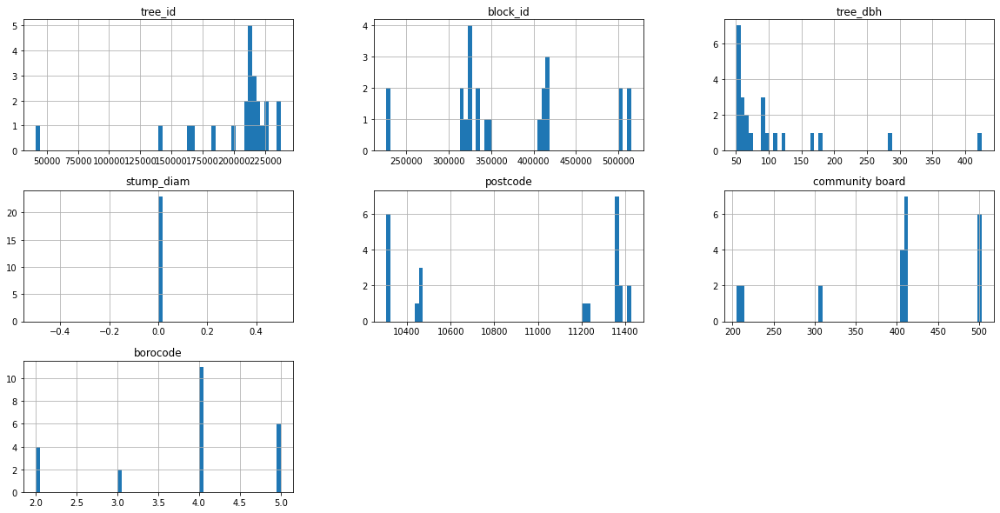

In [30]:
big_tree.hist(bins=60, figsize=(20,10))

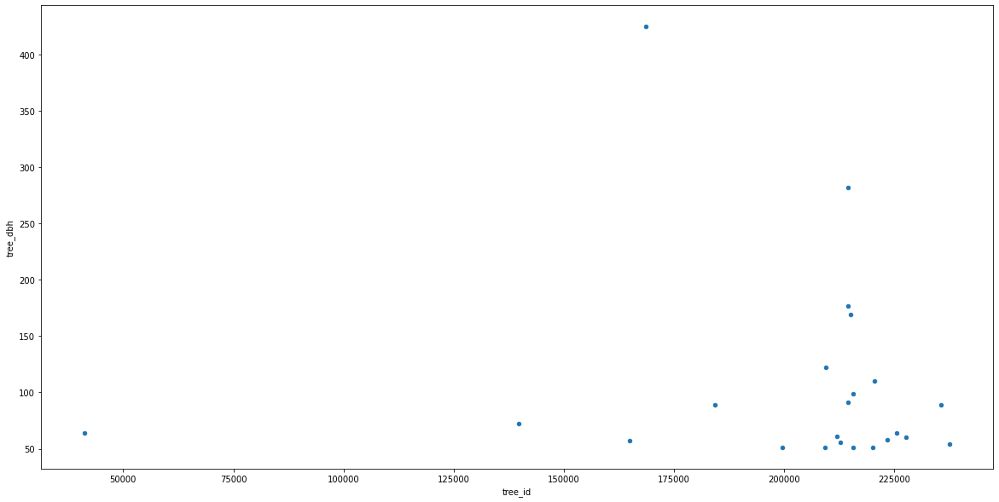

In [32]:
big_tree[['tree_id', 'tree_dbh']].plot(kind = 'scatter', y =  'tree_dbh', x = 'tree_id', figsize=(20,10))

In [33]:
counting=tree_census_subset[[ 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address']]

In [34]:
counting.apply(pd.Series.value_counts)

,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address
1 2 PLACE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
1 4 PLACE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
1 7 AVENUE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0
1 7 AVENUE SOUTH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
1 94 STREET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
1 ARDEN STREET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
1 AVENUE T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
1 BAY 41 STREET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
1 BEACH 105 STREET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.0
1 BEACH 193 STREET,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


In [35]:
tree_census_subset['health'].value_counts()

Good    37612
Fair     9369
Poor     2807
Name: health, dtype: int64

**DATA CLEANING**

In [37]:
mask =( (tree_census_subset['status'] == 'Stump') | ( tree_census_subset['status'] == 'Dead') )

In [38]:
tree_census_subset.loc[mask, 'health'] = tree_census_subset.loc[mask, 'health'].fillna('Not Applicable')

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [39]:
tree_census_subset[tree_census_subset['status'] == 'Stump']

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
37,211205,302080,09/09/2015,0,16,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,21-023 24 DRIVE,11102,Astoria,401,4,Queens
239,203597,301947,09/04/2015,0,15,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,22-063 37 STREET,11105,Astoria,401,4,Queens
641,179766,230466,08/27/2015,0,30,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,2676 BEDFORD AVENUE,11210,Brooklyn,314,3,Brooklyn
644,180619,348834,08/27/2015,0,10,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,113-001 JEWEL AVENUE,11375,Forest Hills,406,4,Queens
646,208828,107238,09/08/2015,0,15,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,301 EAST 66 STREET,10065,New York,108,1,Manhattan
648,181973,337808,08/28/2015,0,25,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,NYC Parks Staff,NaN,No,No,No,No,No,No,No,No,No,192 BEACH 142 STREET,11694,Rockaway Park,414,4,Queens
739,200522,210288,09/03/2015,0,17,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,1970 COYLE STREET,11229,Brooklyn,315,3,Brooklyn
741,174299,217297,08/25/2015,0,15,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,164 MANHATTAN AVENUE,11206,Brooklyn,301,3,Brooklyn
743,198633,415600,09/02/2015,0,16,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,105 BELFAST AVENUE,10306,Staten Island,503,5,Staten Island
774,209649,503989,09/08/2015,0,5,OnCurb,Stump,Not Applicable,NaN,NaN,NaN,NaN,NaN,TreesCount Staff,NaN,No,No,No,No,No,No,No,No,No,165 EAST 176 STREET,10457,Bronx,205,2,Bronx


In [40]:
tree_census_subset.loc[mask] = tree_census_subset.loc[mask].fillna('Not Applicable')

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1884: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, val, pi)


In [41]:
tree_census_subset[tree_census_subset['status'] == 'Stump']

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
37,211205,302080,09/09/2015,0,16,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,21-023 24 DRIVE,11102,Astoria,401,4,Queens
239,203597,301947,09/04/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,22-063 37 STREET,11105,Astoria,401,4,Queens
641,179766,230466,08/27/2015,0,30,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,2676 BEDFORD AVENUE,11210,Brooklyn,314,3,Brooklyn
644,180619,348834,08/27/2015,0,10,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,113-001 JEWEL AVENUE,11375,Forest Hills,406,4,Queens
646,208828,107238,09/08/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,301 EAST 66 STREET,10065,New York,108,1,Manhattan
648,181973,337808,08/28/2015,0,25,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,NYC Parks Staff,Not Applicable,No,No,No,No,No,No,No,No,No,192 BEACH 142 STREET,11694,Rockaway Park,414,4,Queens
739,200522,210288,09/03/2015,0,17,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,1970 COYLE STREET,11229,Brooklyn,315,3,Brooklyn
741,174299,217297,08/25/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,164 MANHATTAN AVENUE,11206,Brooklyn,301,3,Brooklyn
743,198633,415600,09/02/2015,0,16,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,105 BELFAST AVENUE,10306,Staten Island,503,5,Staten Island
774,209649,503989,09/08/2015,0,5,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,165 EAST 176 STREET,10457,Bronx,205,2,Bronx


In [42]:
tree_census_subset[tree_census_subset['status'] == 'Nan']

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough


In [ ]:
missingno.matrix(tree_census_subset)

In [ ]:
tree_census_subset.isna().sum()

In [43]:
tree_census_subset[tree_census_subset['health'].isna()]

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
32889,245041,413012,09/21/2015,16,0,OnCurb,Alive,NaN,Fraxinus pennsylvanica,green ash,None,None,Damage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,84 LUCILLE AVENUE,10309,Staten Island,503,5,Staten Island


In [44]:
tree_census_subset[tree_census_subset['problems'].isna()]

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough


treating missing values

In [45]:
tree_census_subset['problems'].fillna("None", inplace = True)

/usr/local/lib/python3.8/dist-packages/pandas/core/generic.py:6392: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [46]:
tree_census_subset.isna().sum()


tree_id            0
block_id           0
created_at         0
tree_dbh           0
stump_diam         0
curb_loc           0
status             0
health             1
spc_latin          0
spc_common         0
steward            0
guards             0
sidewalk           0
user_type          0
problems           0
root_stone         0
root_grate         0
root_other         0
trunk_wire         0
trnk_light         0
trnk_other         0
brch_light         0
brch_shoe          0
brch_other         0
address            0
postcode           0
zip_city           0
community board    0
borocode           0
borough            0
dtype: int64

In [47]:
tree_census_subset['health'].fillna("Good", inplace = True)

In [48]:
tree_census_subset['spc_latin'].fillna("No Observation", inplace = True)
tree_census_subset['sidewalk'].fillna("NoDamage", inplace = True)
tree_census_subset['spc_common'].fillna("None", inplace = True)
tree_census_subset['guards'].fillna("None", inplace = True)

In [49]:
tree_census_subset.isna().sum()

tree_id            0
block_id           0
created_at         0
tree_dbh           0
stump_diam         0
curb_loc           0
status             0
health             0
spc_latin          0
spc_common         0
steward            0
guards             0
sidewalk           0
user_type          0
problems           0
root_stone         0
root_grate         0
root_other         0
trunk_wire         0
trnk_light         0
trnk_other         0
brch_light         0
brch_shoe          0
brch_other         0
address            0
postcode           0
zip_city           0
community board    0
borocode           0
borough            0
dtype: int64

dealing with outliners

In [50]:
big_tree = tree_census_subset[(tree_census_subset['tree_dbh']>60) | (tree_census_subset['stump_diam']>60)] 
big_tree

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
2405,168583,226040,08/23/2015,425,0,OnCurb,Alive,Good,Quercus bicolor,swamp white oak,1or2,None,Damage,NYC Parks Staff,None,No,No,No,No,No,No,No,No,No,960 STERLING PLACE,11213,Brooklyn,308,3,Brooklyn
4887,139665,409474,08/12/2015,72,0,OffsetFromCurb,Alive,Good,Acer saccharinum,silver maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,52 HEMPSTEAD AVENUE,10306,Staten Island,502,5,Staten Island
6466,166008,226028,08/22/2015,0,72,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,NYC Parks Staff,Not Applicable,No,No,No,No,No,No,No,No,No,1103 STERLING PLACE,11213,Brooklyn,308,3,Brooklyn
6724,209349,415127,09/08/2015,122,0,OnCurb,Alive,Good,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,35 PRIMROSE PLACE,10306,Staten Island,503,5,Staten Island
7042,206818,311117,09/06/2015,0,100,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,57-009 LAWRENCE STREET,11355,Flushing,407,4,Queens
9883,207003,311093,09/06/2015,0,70,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,130-002 57 ROAD,11355,Flushing,407,4,Queens
10083,215075,515054,09/11/2015,169,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,4204 ELY AVENUE,10466,Bronx,212,2,Bronx
11342,206819,311117,09/06/2015,0,140,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,57-005 LAWRENCE STREET,11355,Flushing,407,4,Queens
22452,228273,207454,09/15/2015,0,90,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,826 AVENUE Z,11235,Brooklyn,313,3,Brooklyn
25862,214532,323383,09/10/2015,177,0,OnCurb,Alive,Fair,Robinia pseudoacacia,black locust,1or2,None,NoDamage,Volunteer,None,No,No,No,No,No,No,No,No,No,39-014 221 STREET,11361,Bayside,411,4,Queens


removing the outliers to the mean can be calculated

In [51]:
tree_census_subset = tree_census_subset[(tree_census_subset['tree_dbh']<=60) & (tree_census_subset['stump_diam']<=60)] 
tree_census_subset

creating diferent dataset for stumps and alive trees because if the tree is alive the diameter is 0

In [52]:
tree_census_subset_alive =tree_census_subset[tree_census_subset['status'] == 'Alive']
tree_census_subset_dead_or_Stump = tree_census_subset[(tree_census_subset['status'] == 'Stump')  | (tree_census_subset['status'] == 'Dead')  ]

Tree Species

---



In [53]:
#group by tree type
tree_census_subset_alive.groupby('spc_latin').mean()

,tree_id,block_id,tree_dbh,stump_diam,postcode,community board,borocode
spc_latin,,,,,,,
Acer,183354.338308,344064.781095,11.194030,0.0,10948.303483,404.393035,3.990050
Acer buergerianum,84155.000000,322671.500000,6.250000,0.0,11068.500000,311.750000,3.000000
Acer campestre,220192.534483,361755.367816,8.068966,0.0,10979.172414,335.218391,3.270115
Acer ginnala,220421.482143,342200.017857,8.776786,0.0,10966.562500,363.857143,3.571429
Acer griseum,107138.312500,278195.875000,5.875000,0.0,11085.187500,302.500000,2.937500
Acer negundo,216761.875000,330886.750000,12.500000,0.0,10529.125000,343.875000,3.375000
Acer nigrum,136078.750000,187801.250000,15.000000,0.0,10597.000000,233.500000,2.250000
Acer palmatum,109162.245283,326241.660377,8.000000,0.0,11194.396226,402.792453,3.943396
Acer platanoides,202726.947420,324923.848101,14.010062,0.0,11137.584226,368.117819,3.603376


In [54]:
tree_census_subset_alive.groupby('spc_latin')['tree_dbh'].describe()

,count,mean,std,min,25%,50%,75%,max
spc_latin,,,,,,,,
Acer,201.0,11.194030,6.651854,2.0,6.00,10.0,15.00,35.0
Acer buergerianum,4.0,6.250000,2.362908,3.0,5.25,7.0,8.00,8.0
Acer campestre,174.0,8.068966,4.531950,2.0,5.00,7.0,10.75,28.0
Acer ginnala,112.0,8.776786,4.987750,2.0,5.00,8.0,11.00,29.0
Acer griseum,16.0,5.875000,7.003571,1.0,2.00,3.0,5.75,28.0
Acer negundo,8.0,12.500000,8.896227,5.0,5.00,8.0,22.00,25.0
Acer nigrum,4.0,15.000000,9.128709,4.0,10.75,15.0,19.25,26.0
Acer palmatum,53.0,8.000000,7.049277,1.0,3.00,6.0,10.00,34.0
Acer platanoides,3081.0,14.010062,5.792143,1.0,10.00,13.0,18.00,42.0


In [55]:
stats_alive = tree_census_subset_alive.groupby('spc_latin')['tree_dbh' ].describe().reset_index()[['spc_latin', '25%', '75%' ]]
stats_alive

,spc_latin,25%,75%
0,Acer,6.00,15.00
1,Acer buergerianum,5.25,8.00
2,Acer campestre,5.00,10.75
3,Acer ginnala,5.00,11.00
4,Acer griseum,2.00,5.75
5,Acer negundo,5.00,22.00
6,Acer nigrum,10.75,19.25
7,Acer palmatum,3.00,10.00
8,Acer platanoides,10.00,18.00
9,Acer platanoides 'Crimson King',6.00,11.00


In [ ]:
tree_census_subset_alive.merge(stats_alive, on = 'spc_latin', how = 'left')
tree_census_subset_alive

In [56]:
# normalize tree counts by tree species in each borough
species_counts_boro = []
for b in df.borough.unique().tolist():
    counts = tree_census_subset [tree_census_subset .borough==b].spc_common.value_counts(dropna=True, normalize=True).reset_index()
    counts.columns = ["species", "proportion"]
    species_counts_boro.append(counts)
    print(b)
    display(counts[:10])

Queens


,species,proportion
0,London planetree,0.128801
1,Norway maple,0.095646
2,honeylocust,0.091932
3,pin oak,0.082136
4,Callery pear,0.064481
5,Not Applicable,0.053609
6,littleleaf linden,0.047904
7,Japanese zelkova,0.042144
8,cherry,0.038430
9,Sophora,0.033156


Brooklyn


,species,proportion
0,London planetree,0.182618
1,honeylocust,0.086116
2,pin oak,0.071331
3,littleleaf linden,0.057266
4,Callery pear,0.053300
5,Norway maple,0.051857
6,Not Applicable,0.046087
7,ginkgo,0.043924
8,Sophora,0.038731
9,Japanese zelkova,0.037216


Manhattan


,species,proportion
0,honeylocust,0.192214
1,Callery pear,0.117159
2,pin oak,0.092507
3,ginkgo,0.091897
4,London planetree,0.075543
5,Sophora,0.068343
6,Not Applicable,0.051379
7,Japanese zelkova,0.047840
8,littleleaf linden,0.039053
9,crab apple,0.025384


Staten Island


,species,proportion
0,Callery pear,0.189613
1,London planetree,0.088211
2,red maple,0.069909
3,pin oak,0.059687
4,silver maple,0.055894
5,sweetgum,0.055235
6,Not Applicable,0.043693
7,honeylocust,0.040231
8,Norway maple,0.038417
9,cherry,0.035944


Bronx


,species,proportion
0,honeylocust,0.149372
1,London planetree,0.102881
2,pin oak,0.084497
3,Norway maple,0.056567
4,Callery pear,0.055506
5,littleleaf linden,0.052325
6,Japanese zelkova,0.051087
7,Not Applicable,0.046668
8,Sophora,0.037829
9,cherry,0.030405


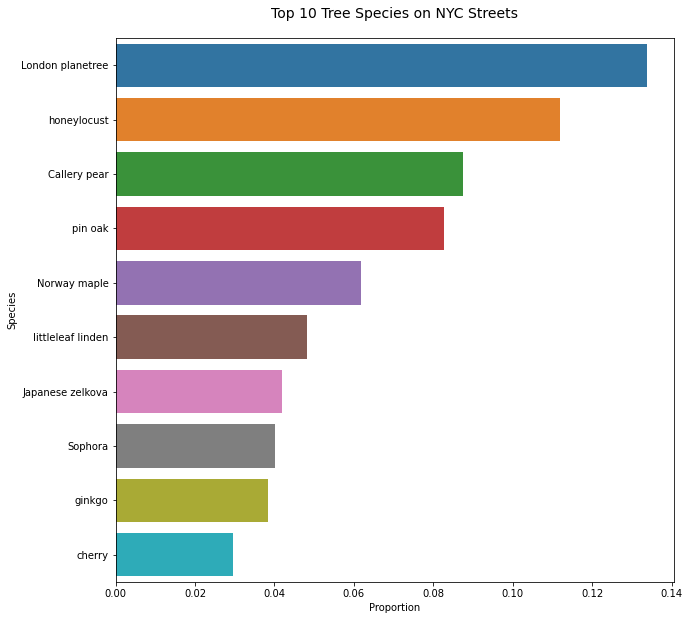

In [58]:
display_top = 10
plt.figure(figsize=(10,10))
ax=plt.subplot()
species_counts = df.spc_common.value_counts(dropna=True, normalize=True).reset_index()
species_counts.columns = ["species", "proportion"]
sns.barplot(data=species_counts[:display_top].sort_values(by='proportion', ascending=False), x='proportion', y='species', palette='tab10')
plt.title('Top {} Tree Species on NYC Streets'.format(display_top), fontsize=14, pad=20)
plt.ylabel('Species')
plt.xlabel('Proportion')
plt.show()


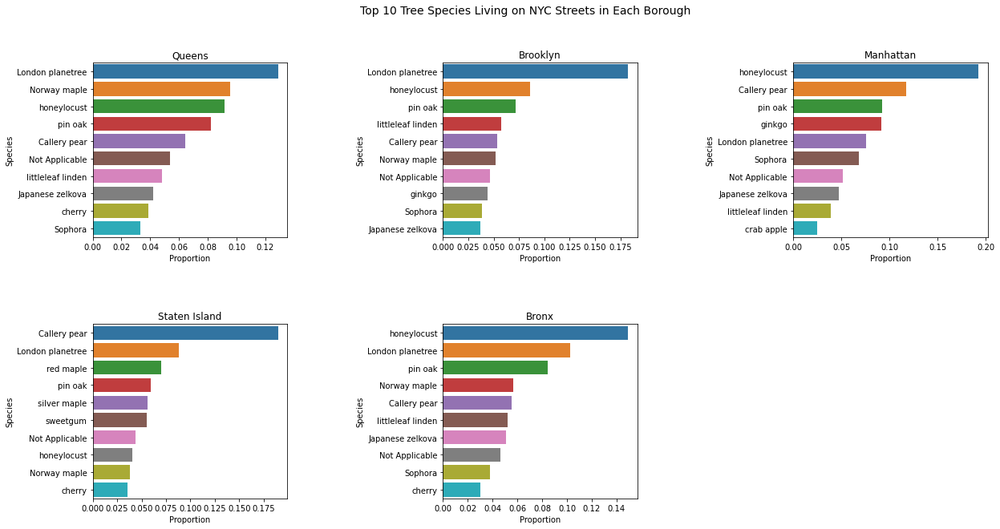

In [59]:
display_top = 10
plt.figure(figsize=(20,10))
plt.suptitle('Top {} Tree Species Living on NYC Streets in Each Borough'.format(display_top), fontsize=14)
for i, b in enumerate(df.borough.unique().tolist()):
    ax=plt.subplot(2, 3, i+1)
    sns.barplot(data=species_counts_boro[i][:display_top].sort_values(by='proportion', ascending=False), x='proportion', y='species', palette='tab10')
    plt.title(b)
    plt.ylabel('Species')
    plt.xlabel('Proportion')
    plt.subplots_adjust(hspace=0.5, wspace=0.8)
# plt.tight_layout()
plt.show()

In [63]:
top_species = species_counts[:10]
print("There are {} different species of tree living on NYC streets.".format(len(species_counts)))

print("\nThe top {} most common tree species represent {}% of the total NYC street trees population.\n{} species make up the remaining {}% of the tree population.\n".format(
   
    len(top_species),
    round(top_species.proportion.sum() * 100, 2),
    len(species_counts) - len(top_species),
    round(species_counts[len(top_species):].proportion.sum() * 100, 2)
))

# print overall statistics
print("Overall, the most common species of tree is the {}.\n{}% of all NYC street trees are {}.".format(
        species_counts.species[0],
        round(species_counts.proportion[0] * 100, 2),
        species_counts.species[0]
    ))
# print remaining top overall statistitcs
for i in range(1,10):
    print("{}% are {}".format(
        round(species_counts.proportion[i] * 100, 2),
        species_counts.species[i]
    ))

# print statistics for each borough
for e, b in enumerate(df.borough.unique().tolist()):
    # print top statistic for borough
    print("\nIn the borough of {}, the most common species of tree is the {}.\n{}% of all NYC street trees in {} are {}.".format(
        b,
        species_counts_boro[e].species[0],
        round(species_counts_boro[e].proportion[0] * 100, 2),
        b,
        species_counts_boro[e].species[0]
    ))
    # print remaining statistics for borough
    for i in range(1,10):
        print("{}% are {}".format(
            round(species_counts_boro[e].proportion[i] * 100, 2),
            species_counts_boro[e].species[i]
        ))

There are 124 different species of tree living on NYC streets.

The top 10 most common tree species represent 67.6% of the total NYC street trees population.
114 species make up the remaining 32.4% of the tree population.

Overall, the most common species of tree is the London planetree.
13.38% of all NYC street trees are London planetree.
11.18% are honeylocust
8.76% are Callery pear
8.26% are pin oak
6.19% are Norway maple
4.82% are littleleaf linden
4.2% are Japanese zelkova
4.01% are Sophora
3.84% are ginkgo
2.96% are cherry

In the borough of Queens, the most common species of tree is the London planetree.
12.88% of all NYC street trees in Queens are London planetree.
9.56% are Norway maple
9.19% are honeylocust
8.21% are pin oak
6.45% are Callery pear
5.36% are Not Applicable
4.79% are littleleaf linden
4.21% are Japanese zelkova
3.84% are cherry
3.32% are Sophora

In the borough of Brooklyn, the most common species of tree is the London planetree.
18.26% of all NYC street trees 

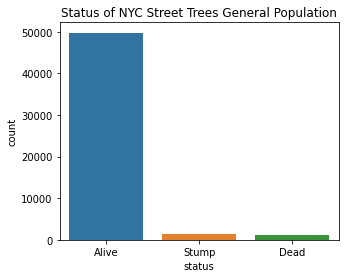

In [64]:
plt.figure(figsize=(5,4))
sns.countplot(data=tree_census_subset, x='status')
plt.title('Status of NYC Street Trees General Population')
plt.show()

In [93]:

# make a copy of the data where tree status is alive and drop na values
data_alive = df[df.status=='Alive'].dropna().copy()
# change the health variable type to categorical and order by value counts
data_alive['health'] = pd.Categorical(data_alive['health'], data_alive.health.value_counts().index.tolist())
data_alive.head()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough,cncldist,st_assem,st_senate,nta,nta_name,boro_ct,state,latitude,longitude,x_sp,y_sp,council district,census tract,bin,bbl
0,180683,348711,08/27/2015,3,0,OnCurb,Alive,Fair,Acer rubrum,red maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,108-005 70 AVENUE,11375,Forest Hills,406,4,Queens,29,28,16,QN17,Forest Hills,4073900,New York,40.723092,-73.844215,1027431.148,202756.7687,29.0,739.0,4052307.0,4.022210e+09
1,200540,315986,09/03/2015,21,0,OnCurb,Alive,Fair,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,Stones,Yes,No,No,No,No,No,No,No,No,147-074 7 AVENUE,11357,Whitestone,407,4,Queens,19,27,11,QN49,Whitestone,4097300,New York,40.794111,-73.818679,1034455.701,228644.8374,19.0,973.0,4101931.0,4.044750e+09
2,204026,218365,09/05/2015,3,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,1or2,None,Damage,Volunteer,None,No,No,No,No,No,No,No,No,No,390 MORGAN AVENUE,11211,Brooklyn,301,3,Brooklyn,34,50,18,BK90,East Williamsburg,3044900,New York,40.717581,-73.936608,1001822.831,200716.8913,34.0,449.0,3338310.0,3.028870e+09
3,204337,217969,09/05/2015,10,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,1027 GRAND STREET,11211,Brooklyn,301,3,Brooklyn,34,53,18,BK90,East Williamsburg,3044900,New York,40.713537,-73.934456,1002420.358,199244.2531,34.0,449.0,3338342.0,3.029250e+09
4,189565,223043,08/30/2015,21,0,OnCurb,Alive,Good,Tilia americana,American linden,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,603 6 STREET,11215,Brooklyn,306,3,Brooklyn,39,44,21,BK37,Park Slope-Gowanus,3016500,New York,40.666778,-73.975979,990913.775,182202.4260,39.0,165.0,3025654.0,3.010850e+09


Tree location on map!

In [94]:
# convert a pandas dataframe to a geo dataframe using geopandas
from shapely.geometry import Point, Polygon
def create_trees_geodf(variable_name, variable_value, data_frame):
    data = data_frame[data_frame[variable_name]  == variable_value]
    geometry = [Point(xy) for xy in zip(data.longitude, data.latitude)]
    geo_data_frame = gpd.GeoDataFrame(data, geometry=geometry)
    return geo_data_frame

In [95]:
# function for plotting geolocation data on nyc borough boundaries map
def plot_geo_data(boundaries, geo_data_frame, boro_names, boro_colors, title, labels, label_variable, legend_title):
    fig = plt.figure(figsize=(15,15))
    ax = plt.subplot()
    shapes = boundaries.plot(ax=ax, alpha=0.3, edgecolor='black', cmap='tab10')
    
    for label, color in labels:
        data = geo_data_frame[geo_data_frame[label_variable]==label]
        marker_size = data.tree_dbh        
        data.plot(ax=ax, markersize=marker_size, alpha=0.3, color=color)
    
    # plt custom legend
    for label, color in labels:
        plt.scatter([], [], c=color, s=200,
                label=str(label))
    plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title=legend_title)                      
    plt.title(title, fontsize=14, pad=20)
    plt.axis("off")
    plt.show()


In [96]:
# Open shapefiles with NYC Borough boundaries

borough_boundaries = gpd.read_file('geo_export_87071461-9196-46f3-8d1b-52fed88fb835.dbf')
borough_boundaries

,boro_code,boro_name,shape_area,shape_leng,geometry
0,2.0,Bronx,1.186612e+09,462958.187332,None
1,5.0,Staten Island,1.623756e+09,325960.628294,None
2,3.0,Brooklyn,1.937593e+09,738745.840717,None
3,4.0,Queens,3.045878e+09,904188.424111,None
4,1.0,Manhattan,6.366027e+08,361212.476577,None


In [91]:
boro_names = borough_boundaries.boro_name.to_list()
boro_colors = ['red', 'green', 'orange', 'blue', 'pink']
dict(list(zip(boro_names, boro_colors)))

{'Bronx': 'red',
 'Staten Island': 'green',
 'Brooklyn': 'orange',
 'Queens': 'blue',
 'Manhattan': 'pink'}

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


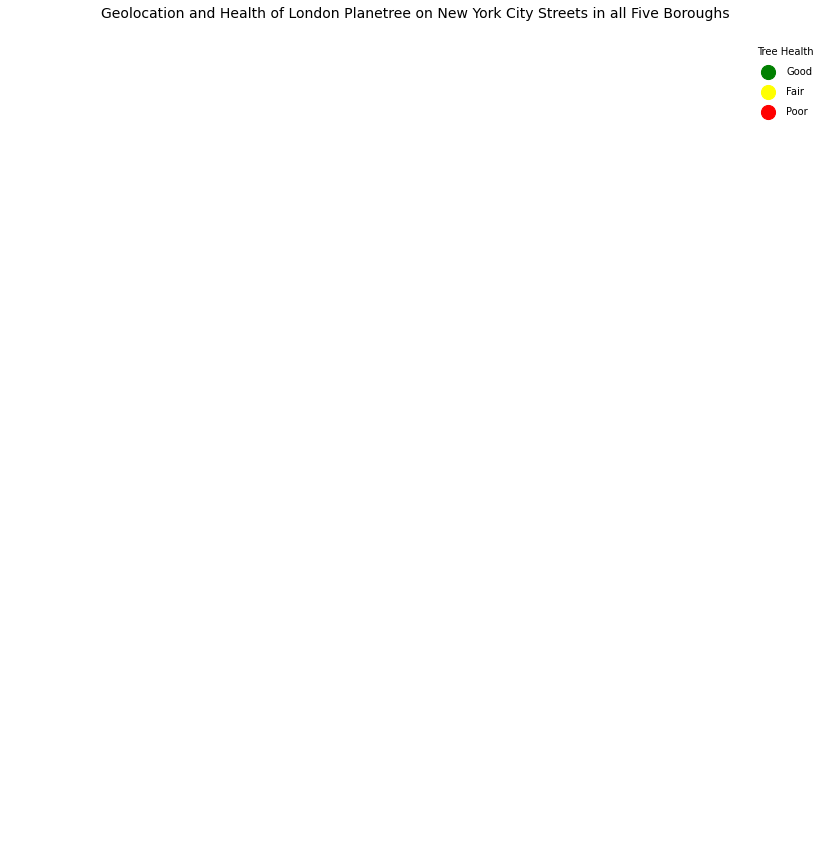

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


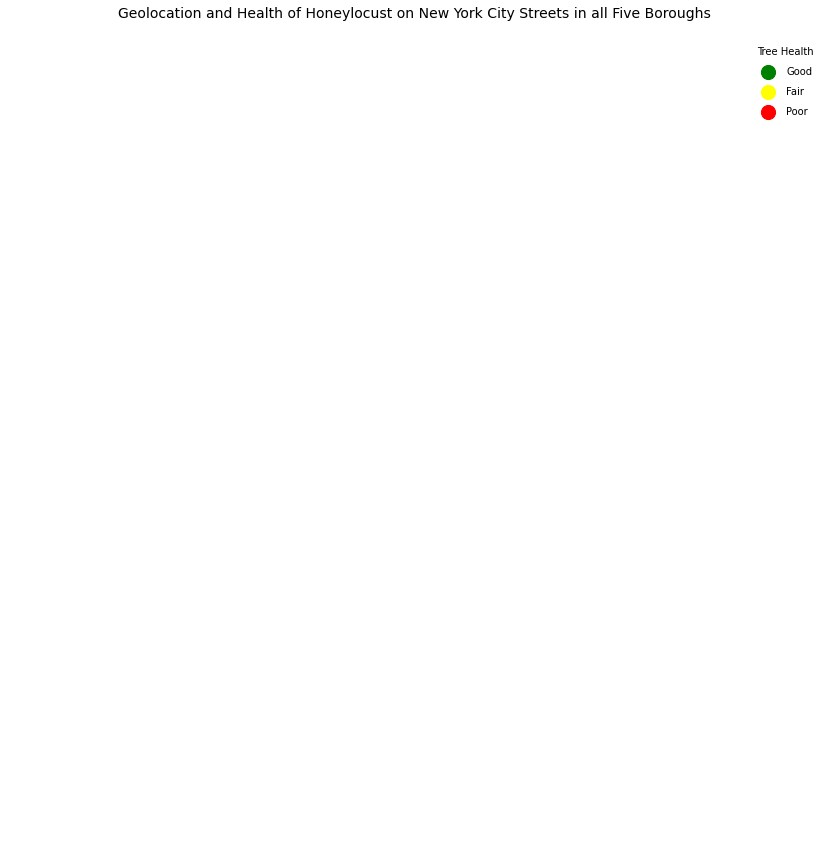

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


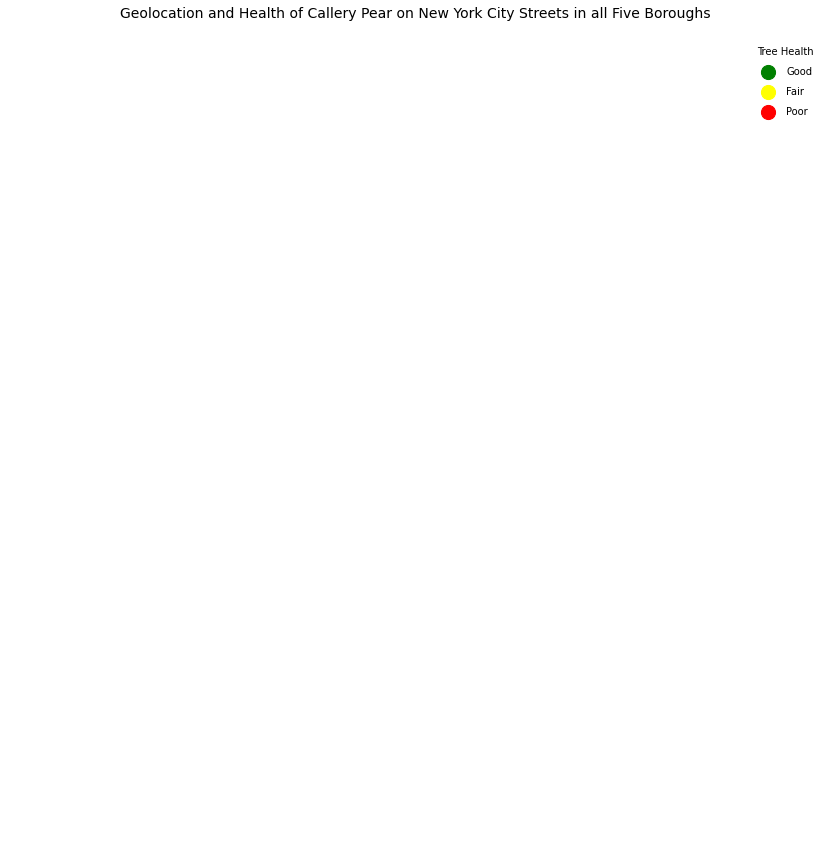

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


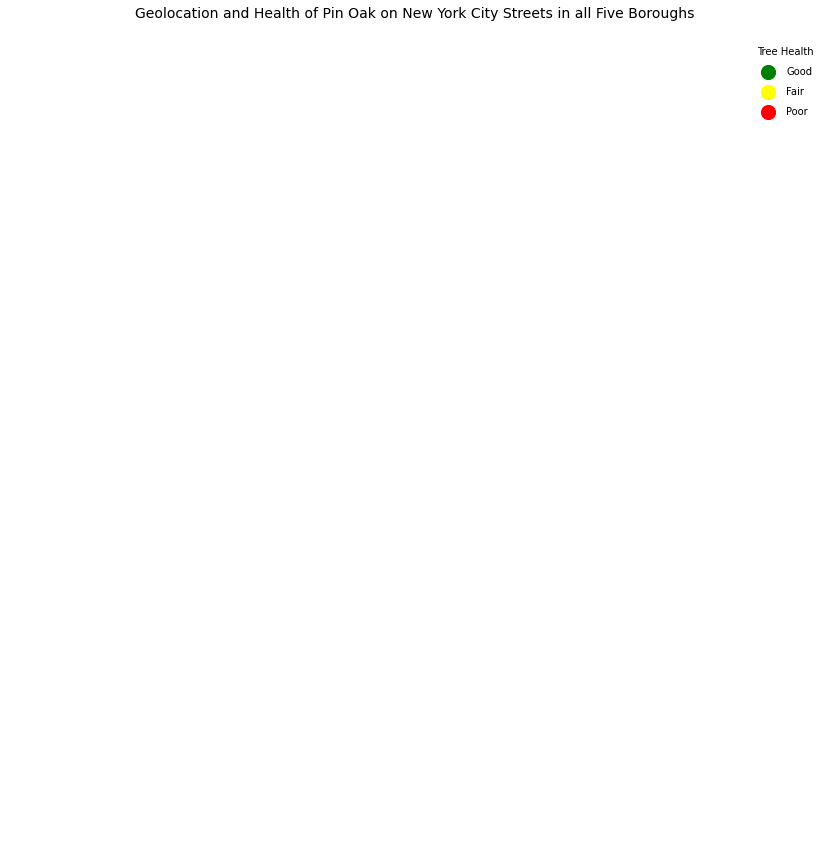

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


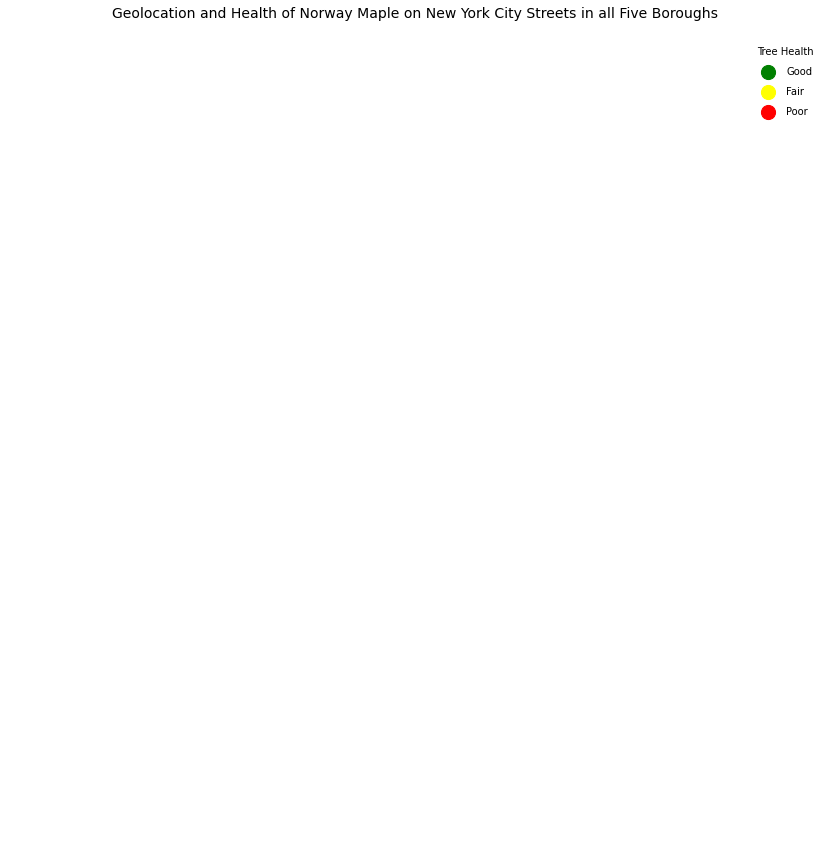

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


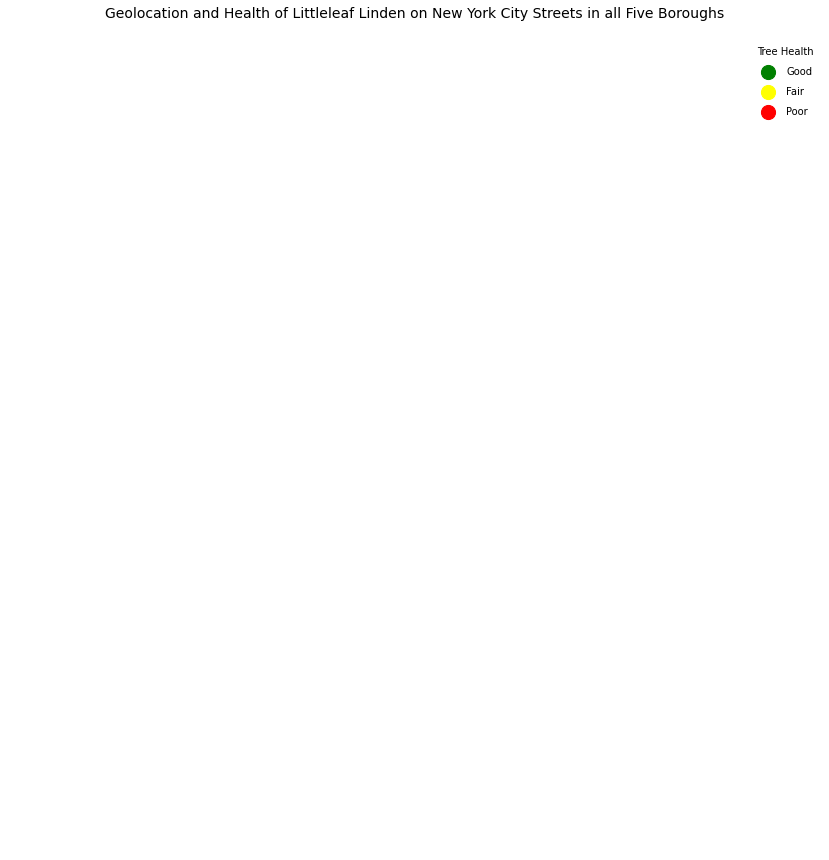

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


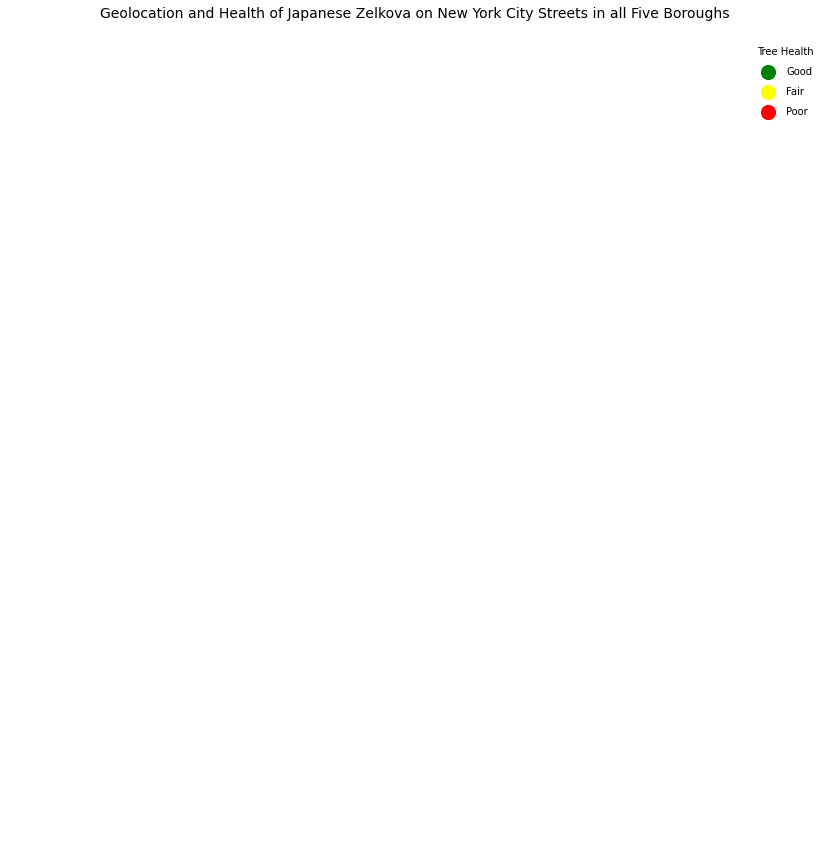

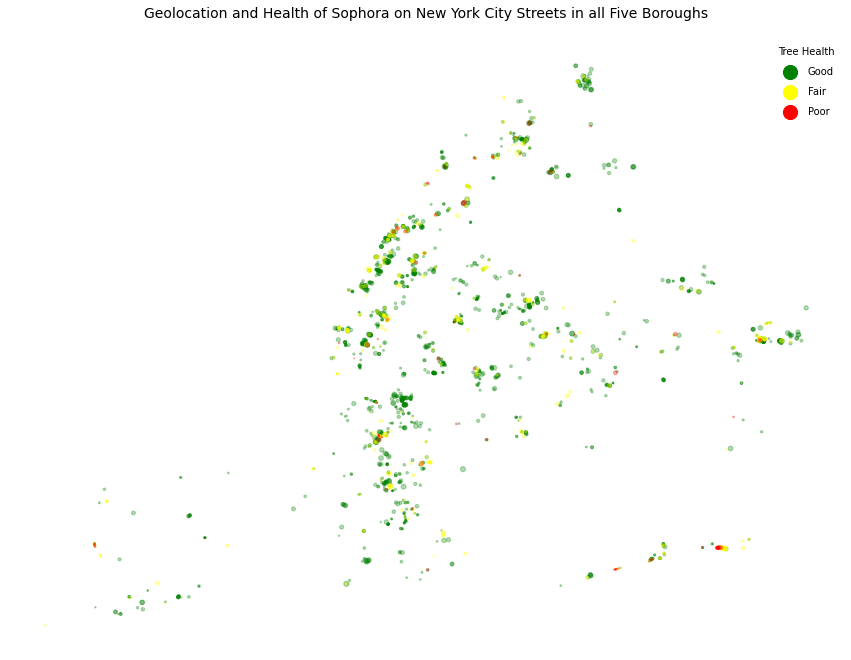

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


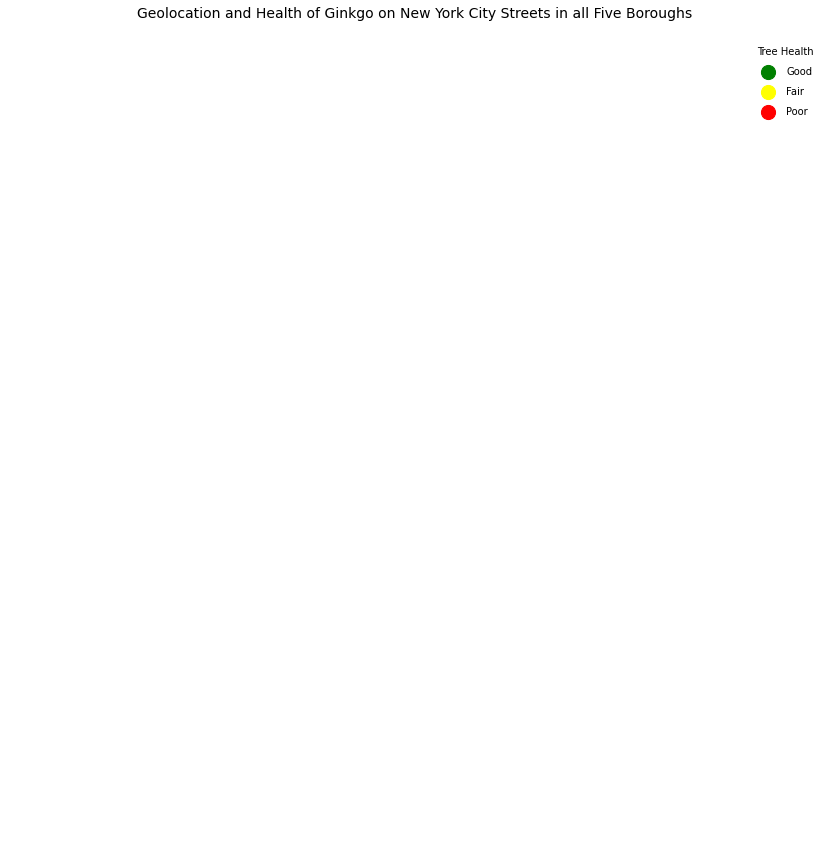

/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/geopandas/plotting.py:693: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  warnings.warn(


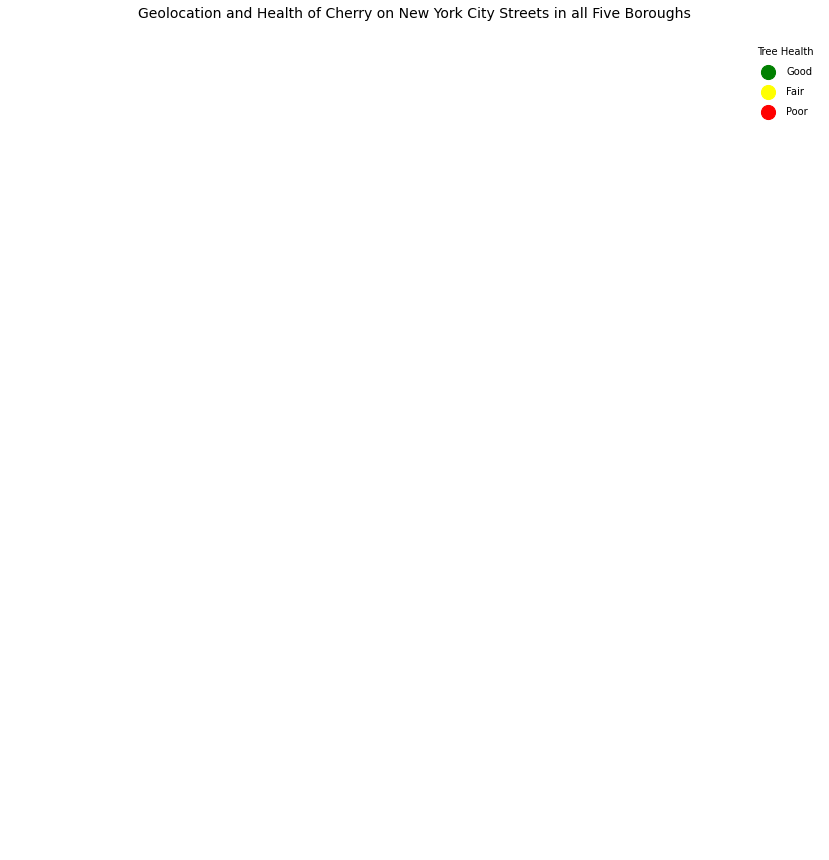

In [92]:
for species in top_species.species:
    plot_geo_data(
        boundaries=borough_boundaries,
        geo_data_frame=create_trees_geodf(
            variable_name='spc_common',
            variable_value=species.title(),
            data_frame=df[['spc_common', 'tree_dbh', 'health', 'longitude', 'latitude']]),
        boro_names=boro_names,
        boro_colors=boro_colors,
        title="Geolocation and Health of {} on New York City Streets in all Five Boroughs".format(species.title()),
        labels = [("Good", "green"), ("Fair", "yellow"), ("Poor", "red")],
        label_variable = 'health',
        legend_title = 'Tree Health'     
    )